## Chapter 9
# Virtual Musical Instruments

In this notebook we will dive more deeply into synthesis models for specific musical instruments, including guitars, pianos, woodwinds, bowed strings and brasses.

## Electric guitars

We pick up where [Chapter 6](https://nbviewer.jupyter.org/github/khiner/notebooks/blob/master/physical_audio_signal_processing/chapter_6_digital_waveguide_models.ipynb) left off, gradually adding complexity and realism, beginning with practical enhancements for the waveguide string model that are useful for many kinds of guitar models.

### Length Three FIR Loop Filter

In Chapter 6 we looked at a simple way to model the [frequency-dependent damping](https://ccrma.stanford.edu/~jos/pasp/Frequency_Dependent_Damping.html) of real vibrating strings. We used the (basically true) assumption that the loss factors throughout the string are [_linear_ and _time-invariant_](https://nbviewer.jupyter.org/github/khiner/notebooks/blob/master/introduction_to_digital_filters/chapter_4_linear_time_invariant_filters.ipynb) in order to commute all loss factors into a single FIR filter in the delay loop (the "loop filter").

Three principled constraints to constructing such a filter were given:

1. The filter should be [linear phase](https://ccrma.stanford.edu/~jos/mdft/Linear_Phase_Terms.html), meaning it should have a constant delay at all frequencies.
2. The filter should be stable - that is, all frequencies should have a gain of at most unity: $\vert G(e^{j\omega T})\vert\leq 1$
3. Assume all losses are insignificant at 0 Hz so that $G(0)=1$

With these constraints, we can express the loop filter (in non-causal form) as having an impulse response of

$h = [g(1), g(0), g(1), 0, ...]$,

and transfer function

$G(z) = g(1) + g(0)z^{-1} + g(1)z^{-2} = g(0)z^{-1} + g(1)[1 + z^{-2}]$,

where $g(0) + 2g(1) = 1$ (DC gain, found by setting $z = 1$).

This leaves only one degree of freedom remaining, which can be interpretted as a _damping_ control. As damping is increased, the duration of free vibration is reduced at all nonzero frequencies, and the decay of higher frequencies is accelerated relative to lower frequencies, provided

$g(0) \geq 2g(1) > 0$.

In [1]:
import sys
sys.path.append('../')
sys.path.append('../introduction_to_digital_filters/')

from ipython_animation import create_animation, DEFAULT_FPS

from matplotlib import pyplot as plt
import numpy as np
from scipy.signal import freqz

%matplotlib inline

In [2]:
plt.rcParams['figure.figsize'] = (12, 4)
np.seterr(divide='ignore')

{'divide': 'warn', 'over': 'warn', 'under': 'ignore', 'invalid': 'warn'}

In [3]:
def plot_frequency_response(w, H, fig=None, frequency_plot=None, phase_plot=None, db=True, lower_db_lim=None, upper_db_lim=None):
    if not fig and not frequency_plot and not phase_plot:
        fig, [frequency_plot, phase_plot] = plt.subplots(2, 1, figsize=(10, 6))

    frequency_plot.plot(w, 20*np.log10(np.abs(H)) if db else np.abs(H), c='r', linewidth=2)
    frequency_plot.grid(True)
    frequency_plot.set_title('Magnitude response', size=16)
    frequency_plot.set_ylabel('Gain (dB)' if db else 'Gain')
    frequency_plot.set_xlabel('Frequency (rad/sample)')
    if db and (lower_db_lim or upper_db_lim):
        frequency_plot.set_ylim(lower_db_lim or -100, upper_db_lim or 1)
    elif not db:
        frequency_plot.set_ylim(0, 1.1)
    frequency_plot.autoscale(enable=True, axis='x', tight=True)

    phase_plot.plot(w, np.angle(H), c='g', linewidth=2)
    phase_plot.grid(True)
    phase_plot.set_title('Phase reponse', size=16)
    phase_plot.set_ylabel('Phase Response (radians)')
    phase_plot.set_xlabel('Frequency (rad/sample)')
    phase_plot.set_yticks(np.pi * np.array([-1, -1/2, 0, 1/2, 1]))
    phase_plot.set_yticklabels(['$-\\pi$', '$-\dfrac{\\pi}{2}$', '$0$', '$\dfrac{\\pi}{2}$', '$\\pi$'])
    phase_plot.autoscale(enable=True, axis='x', tight=True)

    plt.tight_layout()

    return fig, [frequency_plot, phase_plot]

In [4]:
def create_loop_filter_damping_animation(animation_length_seconds=1):
    fig, [frequency_plot, phase_plot] = plt.subplots(2, 1, figsize=(10, 6))

    num_frames = DEFAULT_FPS * animation_length_seconds

    def animate(frame):
        damp = frame / (num_frames - 1)
        fig.suptitle('Length-3 FIR Loop Filter with Damping Control $d$\n$d = {%0.2f}$' % damp, size=18)
        g_0 = (2 - damp) / 2 # [0.5, 1), descending
        g_1 = (1 - g_0) / 2
        b = [g_1, g_0, g_1]
        w, H = freqz(b, [1])

        frequency_plot.cla()
        phase_plot.cla()
        plot_frequency_response(w, H, fig=fig, frequency_plot=frequency_plot, phase_plot=phase_plot, db=False)
        plt.subplots_adjust(top=0.80)    

    return create_animation(fig, plt, animate, length_seconds=animation_length_seconds, default_mode='reflect')

In [5]:
create_loop_filter_damping_animation()

### Length Three FIR Loop Filter with Brightness and Sustain

If we relax the DC normalization constraint so that two degrees of freedom are retained, we can then conveniently control the loop filter with a _brightness_ $B$ and a _sustain_ $S$ according to

$\begin{align}
g_0 &= e^{-6.91P/S}\\
g(0) &= g_0(1 + B) / 2\\
g(1) &= g_0(1 - B) / 4\\
\end{align}$,

where $P$ is the period in seconds (total loop delay), $S$ is the desired sustain time in seconds, the sustain parameter $S$ is the time to decay by -60 dB (or $\approx$ 6.91 time-constants) when brightness $B$ is maximum ($B = 1$) in which case the loop gain is $g_0$ at all frequencies.

In [6]:
def create_loop_filter_brightness_sustain_animation(animation_length_seconds=1):
    fig, [frequency_plot, phase_plot] = plt.subplots(2, 1, figsize=(10, 6))

    num_frames = DEFAULT_FPS * animation_length_seconds

    def animate(frame):
        brightness = 1 - frame / (num_frames - 1)
        sustain = np.exp(frame / 5)
        loop_delay_sec = 1 # assume loop delay of 1 sec for simplicity
        fig.suptitle('Length-3 FIR Loop Filter with Brightness ($B$) and Sustain ($S$) Controls\n$B={%0.2f}, S={%0.1f}$ sec' % (brightness, sustain), size=18)
        t60 = 6.91 # time-constants to decay to -60dB
        g = np.exp(-t60 * loop_delay_sec / sustain)
        g_0 = g * (1 + brightness) / 2
        g_1 = g * (1 - brightness) / 4
        b = [g_1, g_0, g_1]
        w, H = freqz(b, [1])

        frequency_plot.cla()
        phase_plot.cla()
        plot_frequency_response(w, H, fig=fig, frequency_plot=frequency_plot, phase_plot=phase_plot, db=False)
        plt.subplots_adjust(top=0.80)    

    return create_animation(fig, plt, animate, length_seconds=animation_length_seconds, default_mode='reflect')

In [7]:
create_loop_filter_brightness_sustain_animation(animation_length_seconds=1.5)

### One-Zero Loop Filter

If we relax the linear phase constraint, then the simplest case becomes the _one-zero_ digital filter

$G(z) = g(0) + g(1)z^{-1}$.

Then the filter is only linear phase if $g(0) = g(1)$ (you can pause the animation below halfway through to verify!), in which case the phase delay is equal to 1/2 sample. We can compensate for the half-sample delay somewhere elsewhere in the filtered delay loop. Normalizing the DC gain to unity removes the last degree of freedom so that $g(0) = g(1) = 1/2$, and the frequency response is $G(e^{j\omega T}) = \cos(\omega T / 2), |\omega| \leq \pi f_s$ (this is the simplest lowpass filter, explored in [this notebook](https://nbviewer.jupyter.org/github/khiner/notebooks/blob/master/introduction_to_digital_filters/chapter_1_the_simplest_lowpass_filter.ipynb)):

In [8]:
def create_one_zero_loop_filter_animation(animation_length_seconds=1):
    fig, [frequency_plot, phase_plot] = plt.subplots(2, 1, figsize=(10, 6))

    num_frames = int(DEFAULT_FPS * animation_length_seconds)
    if num_frames % 2 == 0:
        num_frames += 1 # odd number to get g_0 = g_1 = 0.5 exactly in the middle
    def animate(frame):
        g_0 = frame / (num_frames - 1)
        g_1 = 1 - g_0

        fig.suptitle('One-Zero Loop Filter\n$g(0)={%0.2f}, g(1)=1-g(0)={%0.2f}$' % (g_0, g_1), size=18)
        b = [g_0, g_1]
        w, H = freqz(b, [1])

        frequency_plot.cla()
        phase_plot.cla()
        plot_frequency_response(w, H, fig=fig, frequency_plot=frequency_plot, phase_plot=phase_plot, db=False)
        plt.subplots_adjust(top=0.80)    

    return create_animation(fig, plt, animate, frames=num_frames, default_mode='reflect')

In [9]:
create_one_zero_loop_filter_animation(animation_length_seconds=1.5)

### The Karplus-Strong Algorithm

![](https://ccrma.stanford.edu/~jos/pasp/img1974.png)

The above is a diagram for a very simple simulation of an ideal string with the simplest frequency-dependent loss filter (the one-zero filter above with $g(0) = g(1) = 0.5$).

Physically we can interpret the delay line as discretely sampling an ideal string twice along its length. (A sample starting at the beginning of the delay line, corresponding to a string termination like a finger or the nut, would travel along the string to the right, then hit the bridge halfway through the delay line, and start traveling back, as it continues through the second half of the delay line to the end, completing one full period.)

All the filtering factors along the string's length, and at its terminations, are commuted together and lumped into the simplest possible frequency-dependent damping filter.

This is what it sounds like:

In [10]:
from DelayLine import DelayLine

fs = 44100

def tick_karplus_strong(delay, output=np.zeros(fs*4)):
    num_ticks = len(output)
    previous_sample = delay.get() # first two `previous_sample`s will be the same.
    for i in range(num_ticks):
        previous_sample = delay.tick(0.5 * (delay.get() + previous_sample))
        output[i] = delay.get()
    return output

In [11]:
a_hz = 440
# Because of the finite sampling of the "string", with no interpolating delay line,
# this may not actually be 440Hz.
a_samples = int(fs / a_hz)

delay = DelayLine(max_delay_length_samples=a_samples)
delay.set_all(np.random.randn(a_samples))

In [12]:
from IPython.display import Audio

Audio(tick_karplus_strong(delay), rate=fs)

The initial conditions of the string positions in the Karplus-Strong model are set to random numbers (white noise), simulating a "pluck" by a _random initial displacement and initial velocity distribution_. This energetic excitation is usually lowpass filtered in practice. This also has the benefit of roughly simulating the typically brighter sound that usually occurs when being played louder.

Let's hear what this sounds like.

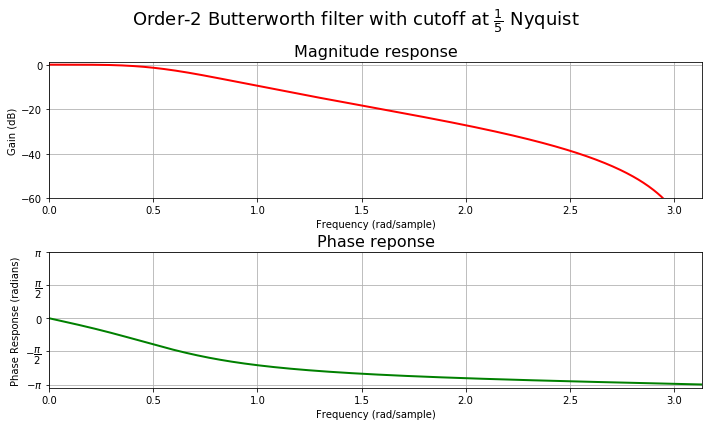

In [13]:
from scipy import signal
from scipy.signal import lfilter, freqz

# Make a simple Order-2 butterworth filter
# We could use the simplest lopwass above, but it doesn't attenuate enough to make the effect obvious.
filter_order = 2
filter_cutoff = 1/5
b, a = signal.butter(filter_order, filter_cutoff, 'low')
fig, _ = plot_frequency_response(*freqz(b, a), lower_db_lim=-60)
fig.suptitle('Order-%d Butterworth filter with cutoff at $\\frac{1}{5}$ Nyquist' % filter_order, size=18)
plt.subplots_adjust(top=0.85)

In [14]:
delay.set_all(lfilter(b, a, np.random.randn(a_samples)))
out = tick_karplus_strong(delay)
Audio(out, rate=fs)

### Extended Karplus-Strong Algorithm

This book doesn't dive into the details of the Extended Karplus-Strong algorithm, but the author has another publication that goes into great detail, with full [Faust](https://faust.grame.fr/) examples: https://ccrma.stanford.edu/realsimple/faust_strings/Extended_Karplus_Strong_Algorithm.html

### Amplifier Feedback

![](https://ccrma.stanford.edu/~jos/pasp/img1992.png)

The Amplifier Feedback Delay, can be adjusted to emphasize certain partial overtones over others. If the Amplifier Feedback Gain is greater than 1 at any frequency, a sustained "feedback howl" will be produced.

Julius suggests an integrator $g/(1-rz^{-1})$ for a simple pre-distortion gain, and a differentiator $(1-rz^{-1})$ for the post-distortion gain.  Let's explicitly code these for an efficient implementation (instead of using `lfilter`, which requires recomputing the state every sample if used in a sample-by-sample way).

$H_{int}(z) = \dfrac{g}{1-rz^{-1}} = \dfrac{Y(z)}{X(z)} \implies Y(z) - rY(z)z^{-1} = gX(z) \implies y[n] - ry[n-1] = gx[n] \implies y[n] = gx[n] + ry[n-1]$

$H_{diff}(z) = 1-rz^{-1} = \dfrac{Y(z)}{X(z)} \implies Y(z) = X(z) - rX(z)z^{-1} \implies y[n] = x[n] - rx[n-1]$

There isn't any more information other than the diagram - let's give it a shot!

In [15]:
class Integrator:
    def __init__(self, g, r):
        self.g = g
        self.r = r
        self.y_1 = 0

    def tick(self, x):
        self.y_1 = self.g * x + self.r * self.y_1
        return self.y_1

class Differentiator:
    def __init__(self, r):
        self.r = r
        self.x_1 = 0
    
    def tick(self, x):
        out = x - self.r * self.x_1
        self.x_1 = x
        return out

def cubic_nonlinearity(x):
    if x <= -1:
        return -2/3
    elif -1 <= x <= 1:
        return x - (x ** 3) / 3
    else:
        return 2/3

def tick_ks_with_amp_feedback(delay, 
                              predistortion_gain=Integrator(0.75, 0.25),
                              postdistortion_gain=Differentiator(0.5),
                              direct_signal_gain=0.5,
                              feedback_delay=DelayLine(max_delay_length_samples=20),
                              feedback_gain=1.1, # could also be frequency-dependent
                              nonlinear_distortion=cubic_nonlinearity,
                              output=np.zeros(fs*4)):
    num_ticks = len(output)
    string_input = 0

    for i in range(num_ticks):
        delay.tick(0.5 * (delay.get() + string_input)) # still using "simplest lowpass" for loop filter
        string_out = delay.get()
        post_distortion_out = nonlinear_distortion(predistortion_gain.tick(string_out))
        string_input = feedback_delay.tick(feedback_gain * post_distortion_out)
        output[i] = string_out + postdistortion_gain.tick(post_distortion_out)
    return output

In [16]:
delay.set_all(lfilter(b, a, np.random.randn(a_samples)))
out = tick_ks_with_amp_feedback(delay)
Audio(out, rate=fs)

This is a primitive attempt, obviously. All the gains are just random guesses at what will sound good and be realistic, the feedback gain is not frequency-dependent. Without realtime changing of some of these parameters (such as the feedback delay), the results will be unrealistically (and boringly) static. But I think the end result still embodies the spirit of amp feedback with distortion!

## Acoustic Guitars

### Building a Synthetic Guitar Bridge Admittance

![](https://ccrma.stanford.edu/~jos/pasp/img2016.png)

The above is an empirically measured admittance of a real guitar bridge. Each peak corresponds to a resonance in the guitar body that is well coupled to the strings via the bridge.

The frequency, amplitude, and width of each peak can be used to find the parameters of a second-order digital resonator in a parallel bank of resonators used to model the bridge impedance. This is a variation on modal synthesis, explored in [this notebook](https://nbviewer.jupyter.org/github/khiner/notebooks/blob/master/physical_audio_signal_processing/chapter_7_lumped_models.ipynb).

As discussed in the [Passive String Terminations](https://ccrma.stanford.edu/~jos/pasp/Passive_String_Terminations.html) section, unamplified acoustic instruments are _passive_ systems, meaning sound energy is transferred within the system and lost to the air. This is an intuitive property - an acoustic guitar bridge should not _add_ energy to any frequency. This imposes constraints on our synthetic guitar bridge admittance filter. Importantly, it will have the property of being _positive real_.

Here we will look at two methods of constructing passive "bridge filters" from measured modal parameters. The first is guaranteed to be positive real but has some drawbacks. The second method gives better results, but has to be possibly modified to give positive real admittance.

I will defer to JOS for an explanation of these methods. (Since all this material is available online, I will be light on explanation and heavy on implementation throughout this notebook.)
* [Passive Reflectance Synthesis - Method 1](https://ccrma.stanford.edu/~jos/pasp/Passive_Reflectance_Synthesis_Method.html)
* [Passive Reflectance Synthesis - Method 2](https://ccrma.stanford.edu/~jos/pasp/Passive_Reflectance_Synthesis_Method_I.html)

### Passive Reflectance Synthesis Method 1

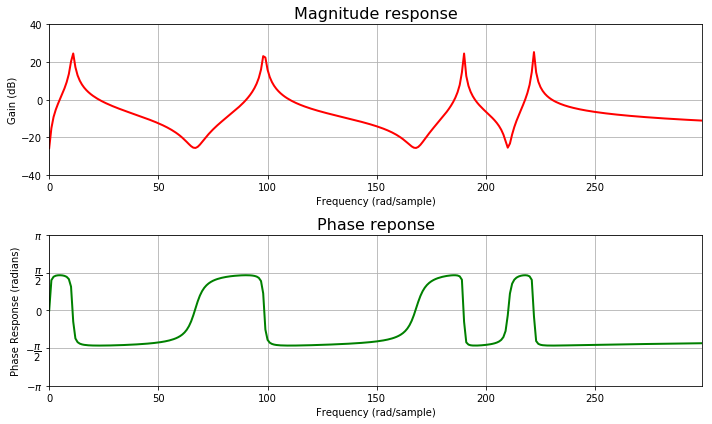

In [17]:
fs = 8192 # sampling rate in Hz
fc = 300 # upper frequency to show
nfft = fs # FFT size

# Measured guitar body resonances
resonant_frequencies = np.array([4.64, 96.52, 189.33, 219.95])
resonant_bandwidths = np.array([20, 20, 10, 10])
num_sections = len(resonant_frequencies)

R = np.exp(-np.pi * resonant_bandwidths / fs) # Pole radii
theta = 2 * np.pi * resonant_frequencies / fs  # Pole angles
poles = R * np.exp(1j * theta)
A1 = -2 * R * np.cos(theta) # 2nd-order section coefficients
A2 = R**2                   # 2nd-order section coefficients
denominators = np.array([np.ones(len(A1)), A1, A2]).transpose()
A = np.concatenate([[1], np.zeros(2 * num_sections)])
for i in range(num_sections):
    # Use FIR filtering to implement polynomial multiplication
    A = lfilter(denominators[i], 1, A)

# Now A contains the (stable) denominator of the desired bridge admittance. We want to construct a numerator which gives a positive-real result. First create a passive reflectance and then compute the corresponding PR admittance.

g = 0.9 # Uniform loss factor

B = g * A[::-1] # g*Flip(A) / A = desired allpass

B_admittance = A - B
A_admittance = A + B
B_admittance /= A_admittance[0] # Renormalize
A_admittance /= A_admittance[0]

_, spec = freqz(B_admittance, A_admittance, nfft, 'whole')

nc = round(nfft * fc / fs)

f = fs * np.arange(nc) / nfft
_ = plot_frequency_response(f[:nc], spec[:nc], lower_db_lim=-40, upper_db_lim=40)

### Passive Reflectance Synthesis Method 2

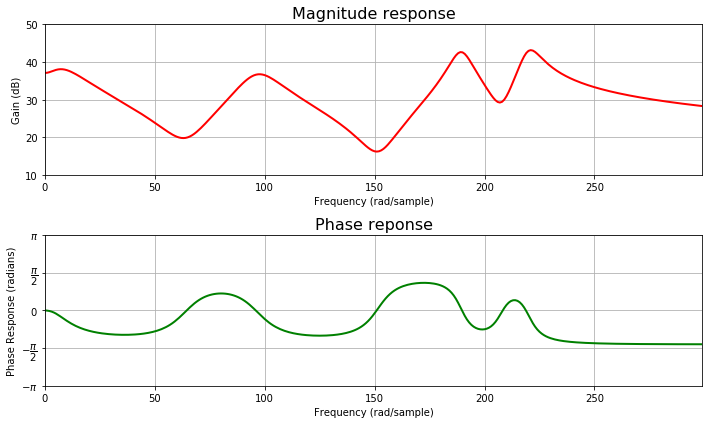

In [18]:
# Same as Method 1 for poles...

# Construct a resonator as a sum of arbitrary modes with unit residues

B = np.zeros(2 * num_sections + 1)
impulse = np.concatenate([[1], np.zeros(2 * num_sections)])
for i in range(num_sections):
    # `filter` does polynomial division here
    B += lfilter(A, denominators[i], impulse)

# Add a near-zero at dc
B = lfilter([1, -0.995], 1, B)

_, spec = freqz(B, A, nfft, 'whole')
_ = plot_frequency_response(f[:nc], spec[:nc], lower_db_lim=10, upper_db_lim=50)

Comparing this to the empirically measured bridge admittance again, it looks like a pretty close match, except that it is unstable. (Note that this closely matches the result in the book.)

![](https://ccrma.stanford.edu/~jos/pasp/img2016.png)

## String Excitation _(or, where I step off this train)_

In [240]:
def animate_waveguide(waveguide, pickup_x=None, num_frames=None, fps=10, ticks_per_frame=1):
    L = waveguide.length_samples
    wv_label = waveguide.wave_variable_label
    L_indices = np.arange(L)
    d_l = waveguide.d_l
    d_r = waveguide.d_r
    num_frames = num_frames or (L - 1) * 2

    if pickup_x is not None:
        fig, (y_plot, y_r_plot, y_l_plot, pickup_plot) = plt.subplots(4, 1, figsize=(14, 4 * 3))
    else:
        fig, (y_plot, y_r_plot, y_l_plot) = plt.subplots(3, 1, figsize=(14, 3 * 3))

    y_r_ax, = y_r_plot.plot(d_r.get_all()[::-1], label='${}_r$'.format(wv_label),
                            linestyle='--', c='b', alpha=0.7, linewidth=2)
    y_l_ax, = y_l_plot.plot(d_l.get_all(), label='${}_l$'.format(wv_label),
                            linestyle='--', c='b', alpha=0.7, linewidth=2)
    y_ax, = y_plot.plot(d_r.get_all()[::-1] + d_l.get_all(), label='${0}_l + {0}_r$'.format(wv_label),
                        linewidth=3, c='b')

    y_plot.set_title('${0}(t,x) = {0}_r(t,x) + {0}_l(t,x)$'.format(wv_label), size=16)
    y_r_plot.set_title('${}_r(t,x)$'.format(wv_label), size=16)
    y_l_plot.set_title('${}_l(t,x)$'.format(wv_label), size=16)

    if pickup_x is not None:
        for plot in [y_r_plot, y_l_plot]:
            plot.axvline(pickup_x, label='Pickup $x$', linewidth=3, c='black')
        pickup_data = np.zeros(num_frames)
        pickup_data[0] = waveguide.tap_pickup(pickup_x)
        pickup_ax, = pickup_plot.plot(pickup_data, c='black')
        pickup_plot.set_xlim(0, num_frames - 1)
        pickup_plot.set_ylim(-1.2, 1.2)
        pickup_plot.grid(True)
        pickup_plot.set_title('Signal from pickup at $x={}$'.format(pickup_x), size=16)
        pickup_plot.set_xlabel('$t$ (samples) $\\longrightarrow$')

    for plot in [y_plot, y_r_plot, y_l_plot]:
        plot.legend()
        plot.grid(True)
        plot.set_ylabel('$y$')
        plot.set_ylim(-1.2, 1.2)
        plot.set_xlim(0, L - 1)
        plot.set_xticks(L_indices)

    y_plot.set_xlabel('$x$')
    for plot in [y_r_plot, y_l_plot]:
        plot.set_xlabel('Delay Line Sample Index')

    y_r_plot.set_xticklabels(L_indices[::-1])
    plt.tight_layout()

    def animate(frame):
        if frame < 1:
            return

        for _ in range(ticks_per_frame):
            waveguide.tick()

        y_r_x = np.roll(L_indices, -d_l.read_sample)[::-1]
        y_r = d_r.get_all()[y_r_x]
        y_r_ax.set_ydata(y_r)
        y_r_plot.set_xticklabels(y_r_x)

        y_l_x = np.roll(L_indices, -d_l.read_sample)
        y_l = d_l.get_all()[y_l_x]
        y_l_ax.set_ydata(y_l)
        y_l_plot.set_xticklabels(y_l_x)

        y_ax.set_ydata(y_r + y_l)

        if pickup_x:
            pickup_data[frame] = waveguid.tap_pickup(pickup_x)
            pickup_ax.set_ydata(pickup_data)

    return create_animation(fig, plt, animate, frames=num_frames, frames_per_second=fps)

In [245]:
from DelayLine import DelayLine

class Waveguide:
    def __init__(self, length_samples=21, wave_variable_label='y'):
        self.length_samples = length_samples
        self.d_l = DelayLine(length_samples)
        self.d_r = DelayLine(length_samples)
        # make a "pluck" triangle for initial state
        y_init = np.zeros(length_samples)
        y_init[length_samples // 4 + 1:length_samples // 2 + 1] = np.linspace(0, 1, length_samples // 4)
        y_init[length_samples // 2:3 * length_samples // 4] = np.linspace(1, 0, length_samples // 4)
        self.set_initial_shape(y_init)
        self.bridge_reflection_y_0 = 0 # memory for single pole lowpass filter at bridge
        self.wave_variable_label = wave_variable_label

    def set_initial_shape(self, y_init):
        y_l = y_init / 2
        y_r = y_init[::-1] / 2
        self.d_r.tick_all(y_l)
        self.d_l.tick_all(y_r)

    def tick(self):
        r = self.d_r.get_tap(1) # least recent sample from rightgoing wave component - traveling into nut
        l = self.d_l.get_tap(1) # least recent sample from leftgoing wave component - traveling into bridge
        self.d_l.tick(-r) # negative reflection at right rigid termination (nut)
        self.d_r.tick(-l) # negative reflection at left termination (bridge)

    def tap_pickup(self, pickup_sample):
        return self.d_l.get_tap(pickup_sample) + self.d_r.get_tap(self.length_samples - pickup_sample)

class WaveguideWithYieldingBridge(Waveguide):
    def tick(self):
        r = self.d_r.get_tap(1) # least recent sample from rightgoing wave component - traveling into nut
        l = self.d_l.get_tap(1) # least recent sample from leftgoing wave component - traveling into bridge
        self.d_l.tick(-r) # negative reflection at right rigid termination (nut)
        self.d_r.tick(-self.bridge_reflection(l)) # negative, yielding reflection at left termination (bridge)

    # One-pole lowpass with feedback coefficient of 0.5
    def bridge_reflection(self, in_sample):
        out_sample = 0.5 * self.bridge_reflection_y_0 + 0.5 * in_sample
        self.bridge_reflection_y_0 = out_sample
        return out_sample

In [98]:
waveguide = WaveguideWithYieldingBridge(length_samples=21)
animate_waveguide(waveguide, num_frames=waveguide.length_samples * 6, fps=20, ticks_per_frame=3, pickup_x=4)

![](https://ccrma.stanford.edu/~jos/pasp/img2172.png)

... translated to _displacement_ wave variables (note that the only change is an inversion at the filter):

![](https://ccrma.stanford.edu/~jos/pasp/img2209.png)

In [360]:
class ExcitationReflectionFilter():
    def __init__(self, g, p):
        self.g = g
        self.p = p
        self.z_1 = 0
    
    def tick(self, x):
        new_z_1 = self.g * x + self.p * self.z_1
        output = new_z_1 - self.z_1
        self.z_1 = new_z_1
        return output

class WaveguideWithYieldingBridgeAndHammerExcitation(Waveguide):
    def __init__(self, length_samples=42, pickup_sample=42//4, excitation_sample=42//2, wave_variable_label='y'):
        self.length_samples = length_samples
        self.excitation_sample = excitation_sample
        self.dl_length_samples = length_samples // 2
        self.pickup_sample = pickup_sample
        self.d_r1 = DelayLine(self.excitation_sample)
        self.d_r2 = DelayLine(self.length_samples - self.excitation_sample)
        self.d_l1 = DelayLine(self.excitation_sample)
        self.d_l2 = DelayLine(self.length_samples - self.excitation_sample)
        self.set_initial_shape(np.zeros(length_samples))
        self.bridge_reflection_y_0 = 0 # memory for single pole lowpass filter at bridge
        self.excitation_reflection_filter = ExcitationReflectionFilter(g=0.9, p=0.9)
        self.wave_variable_label = wave_variable_label
        self.excitation_y = 0
        self.excitation_velocity = 0.04 # y-units-per-sample TODO y-units-per-second
        self.triggered = False

    def set_initial_shape(self, y_init):
        y_r = y_init / 2
        y_l = y_init / 2

        self.d_r1.tick_all(y_r[self.length_samples - self.excitation_sample:])
        self.d_r2.tick_all(y_r[:self.length_samples - self.excitation_sample])
        self.d_l1.tick_all(y_l[self.length_samples - self.excitation_sample:][::-1])
        self.d_l2.tick_all(y_l[:self.length_samples - self.excitation_sample][::-1])

    def get_all(self):
        y_r1 = np.roll(self.d_r1.get_all(), -self.d_r1.read_sample)[::-1]
        y_r2 = np.roll(self.d_r2.get_all(), -self.d_r2.read_sample)[::-1]
        y_l1 = np.roll(self.d_l1.get_all(), -self.d_l1.read_sample)
        y_l2 = np.roll(self.d_l2.get_all(), -self.d_l2.read_sample)
        left_y = y_r1 + y_l1
        right_y = y_r2 + y_l2
        excitation_y = self.excitation_y if self.excitation_offset() > 0 else (left_y[-1] + right_y[0]) / 2
        return np.concatenate([left_y, [excitation_y], right_y])

    def trigger(self):
        self.triggered = True

    def tick(self):
        return self.tick(0)

    def tick(self):
        if self.excitation_y > 0.8: # TODO should be based on string tension/string energy
            self.triggered = False # hammer starts bouncing back
        if self.triggered:
            self.excitation_y += self.excitation_velocity # hammer driving into the string
        elif self.excitation_y > -0.8:
            self.excitation_y -= self.excitation_velocity # hammer bouncing back TODO different velocity

        into_excitation_rightgoing = self.d_r1.get_tap(1)
        into_right_termination = self.d_r2.get_tap(1)
        into_excitation_leftgoing = self.d_l2.get_tap(1)
        into_left_termination = self.d_l1.get_tap(1)

        self.d_r1.tick(-self.bridge_reflection(into_left_termination))
        self.d_l2.tick(-into_right_termination)

        into_excitation = self.excitation_offset()
        if into_excitation > 0:
            out_of_excitation = self.excitation_reflection_filter.tick(into_excitation)
            self.d_r2.tick(into_excitation_rightgoing + out_of_excitation)
            self.d_l1.tick(into_excitation_leftgoing + out_of_excitation)
        else:
            self.d_r2.tick(into_excitation_rightgoing)
            self.d_l1.tick(into_excitation_leftgoing)

        return self.tap_pickup()

    def excitation_offset(self):
        into_excitation_rightgoing = self.d_r1.get_tap(1)
        into_excitation_leftgoing = self.d_l2.get_tap(1)
        return self.excitation_y - (into_excitation_rightgoing + into_excitation_leftgoing)

    def tap_pickup(self, pickup_sample=None):
        pickup_sample = pickup_sample or self.pickup_sample
        # TODO support pickup_sample > half string length (into second delayline half)
        return self.d_l1.get_tap(pickup_sample) + self.d_r1.get_tap(self.dl_length_samples - pickup_sample)

    # One-pole lowpass with feedback coefficient of 0.5
    def bridge_reflection(self, in_sample):
        out_sample = 0.5 * self.bridge_reflection_y_0 + 0.5 * in_sample
        self.bridge_reflection_y_0 = out_sample
        return out_sample

In [361]:
from matplotlib import gridspec

def animate_waveguide_with_excitation(waveguide, pickup_x=None, num_frames=None, fps=10, ticks_per_frame=1):
    L = waveguide.dl_length_samples
    wv_label = waveguide.wave_variable_label
    L_indices = np.arange(L)
    d_r1 = waveguide.d_r1
    d_r2 = waveguide.d_r2
    d_l1 = waveguide.d_l1
    d_l2 = waveguide.d_l2

    num_frames = num_frames or (L - 1) * 2


    fig = plt.figure(constrained_layout=True, figsize=(14, 4 * 3))
    if pickup_x is not None:
        gs = gridspec.GridSpec(nrows=4, ncols=2, figure=fig)
        y_plot = fig.add_subplot(gs[0, :])
        y_r1_plot = fig.add_subplot(gs[1, 0])
        y_r2_plot = fig.add_subplot(gs[1, 1])
        y_l1_plot = fig.add_subplot(gs[2, 0])
        y_l2_plot = fig.add_subplot(gs[2, 1])
        pickup_plot = fig.add_subplot(gs[3, :])
    else:
        gs = gridspec.GridSpec(nrows=3, ncols=2, figure=fig)
        y_plot = fig.add_subplot(gs[0, :])
        y_r1_plot = fig.add_subplot(gs[1, 0])
        y_r2_plot = fig.add_subplot(gs[1, 1])
        y_l1_plot = fig.add_subplot(gs[2, 0])
        y_l2_plot = fig.add_subplot(gs[2, 1])

    y_r1_ax, = y_r1_plot.plot(d_r1.get_all()[::-1], label='${}_r1$'.format(wv_label),
                              linestyle='--', c='b', alpha=0.7, linewidth=2)
    y_r2_ax, = y_r2_plot.plot(d_r2.get_all()[::-1], label='${}_r2$'.format(wv_label),
                              linestyle='--', c='b', alpha=0.7, linewidth=2)
    y_l1_ax, = y_l1_plot.plot(d_l1.get_all(), label='${}_l1$'.format(wv_label),
                              linestyle='--', c='b', alpha=0.7, linewidth=2)
    y_l2_ax, = y_l2_plot.plot(d_l2.get_all(), label='${}_l2$'.format(wv_label),
                              linestyle='--', c='b', alpha=0.7, linewidth=2)

    y_ax, = y_plot.plot(waveguide.get_all(), label='${0}_l + {0}_r$'.format(wv_label), linewidth=3, c='b')

    excitation_y_ax = y_plot.scatter([waveguide.excitation_sample], [waveguide.excitation_y], c='red')

    y_plot.set_title('${0}(t,x) = {0}_r(t,x) + {0}_l(t,x)$'.format(wv_label), size=16)
    y_r1_plot.set_title('${}_r1(t,x)$'.format(wv_label), size=16)
    y_r2_plot.set_title('${}_r2(t,x)$'.format(wv_label), size=16)
    y_l1_plot.set_title('${}_l1(t,x)$'.format(wv_label), size=16)
    y_l2_plot.set_title('${}_l2(t,x)$'.format(wv_label), size=16)

    if pickup_x is not None:
        for plot in [y_r1_plot, y_l1_plot]:
            plot.axvline(pickup_x, label='Pickup $x$', linewidth=3, c='black')
        pickup_data = np.zeros(num_frames)
        pickup_data[0] = waveguide.tap_pickup(pickup_x)
        pickup_ax, = pickup_plot.plot(pickup_data, c='black')
        pickup_plot.set_xlim(0, num_frames - 1)
        pickup_plot.set_ylim(-1.2, 1.2)
        pickup_plot.grid(True)
        pickup_plot.set_title('Signal from pickup at $x={}$'.format(pickup_x), size=16)
        pickup_plot.set_xlabel('$t$ (samples) $\\longrightarrow$')

    for plot in [y_plot, y_r1_plot, y_r2_plot, y_l1_plot, y_l2_plot]:
        plot.legend()
        plot.grid(True)
        plot.set_ylabel('$y$')
        plot.set_ylim(-1.2, 1.2)
    y_plot.set_xlim(0, 2 * L)
    y_plot.set_xlabel('$x$')
    for plot in [y_r1_plot, y_r2_plot, y_l1_plot, y_l2_plot]:
        plot.set_xlim(0, L - 1)
        plot.set_xticks(L_indices)
        plot.set_xlabel('Delay Line Sample Index')

    y_r1_plot.set_xticklabels(L_indices[::-1])
    y_r2_plot.set_xticklabels(L_indices[::-1])
    plt.tight_layout()

    def animate(frame):
        if frame < 1:
            waveguide.trigger()
            return

        for _ in range(ticks_per_frame):
            waveguide.tick()

        y_r1_x = np.roll(L_indices, -d_r1.read_sample)[::-1]
        y_r1 = d_r1.get_all()[y_r1_x]
        y_r1_ax.set_ydata(y_r1)
        y_r1_plot.set_xticklabels(y_r1_x)

        y_r2_x = np.roll(L_indices, -d_r2.read_sample)[::-1]
        y_r2 = d_r2.get_all()[y_r2_x]
        y_r2_ax.set_ydata(y_r2)
        y_r2_plot.set_xticklabels(y_r2_x)

        y_l1_x = np.roll(L_indices, -d_l1.read_sample)
        y_l1 = d_l1.get_all()[y_l1_x]
        y_l1_ax.set_ydata(y_l1)
        y_l1_plot.set_xticklabels(y_l1_x)

        y_l2_x = np.roll(L_indices, -d_l2.read_sample)
        y_l2 = d_l2.get_all()[y_l2_x]
        y_l2_ax.set_ydata(y_l2)
        y_l2_plot.set_xticklabels(y_l2_x)

        y_ax.set_ydata(waveguide.get_all())
        excitation_y_ax.set_offsets([waveguide.excitation_sample, waveguide.excitation_y])

        if pickup_x:
            pickup_data[frame] = waveguide.tap_pickup(pickup_x)
            pickup_ax.set_ydata(pickup_data)

    return create_animation(fig, plt, animate, frames=num_frames, frames_per_second=fps)

In [357]:
waveguide = WaveguideWithYieldingBridgeAndHammerExcitation(length_samples=42)
animate_waveguide_with_excitation(waveguide, num_frames=waveguide.length_samples * 2, fps=10, ticks_per_frame=1, pickup_x=4)

/usr/local/lib/python3.7/site-packages/matplotlib/figure.py:2144: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  warnings.warn("This figure was using constrained_layout==True, "


In [362]:
waveguide = WaveguideWithYieldingBridgeAndHammerExcitation(length_samples=a_samples, pickup_sample=a_samples // 4)
waveguide.trigger()
out = [waveguide.tick() for i in range(fs * 6)]
Audio(out, rate=fs)

... with collision detection:

![](https://ccrma.stanford.edu/~jos/pasp/img2243.png)

Beginning with the String Excitation section and moving forward throughout this chapter, the material quickly becomes more theoretical with much less concrete backing for implementation. The chapter covers an immense amount of material, informed by a wide array of literature. Very little guidance is given throughout on possible values for variables, Matlab code examples, charts, or practical implementation advice. Such critical things as which wave variable to choose and how to extract signals from them are given only high-level theoretical treatment. I found it difficult to know where to start implementing even some basic scattering junctions and incorporating them into a waveguide implementation. It's also difficult to find code examples online.

My goal in writing a guide to this book was to create a journey that builds concretely from first principles to "good sounding" instrument models. Basically, this is about as far as I can go on this journey without more external support and guidance. If anything, I've learned that this field is highly specicalized. Very few people are actually implementing these things, and the number of people sharing concrete implementations of these complex models in publicly available code approaches zero.

This series of books is, far and away and without a doubt, the most valuable resource on the topic of physical modelling, and I would argue audio DSP in general. It is an understatement that the work of Julius Smith over the course of his career has advanced the field dramatically. I hope that more researchers in these areas publish works half as generous as these. I also hope more hobbyists and enthusiasts (or some of JOS's students at Stanford! ☺) step out further than I have, sharing implementations, guides and animations to the community.

## Where to go from here?

The next (or, as the author suggests, _parallel_) book in the series is [Specral Audio Signal Processing](https://ccrma.stanford.edu/~jos/sasp/). I plan on getting to that book and creating a chapter-by-chapter notebook series like I have for the rest of the books. It looks _much_ less esoteric, and focuses on more well-established domains such as the short-time-fourier-transform. I'm looking forward to getting to it as I'm very interested in time & pitch warping, and in general more abstract, non-physical audio manipulation methods. However, as I don't have as much free time these days, I'm feeling the itch to step away from the academic side for awhile and get back to "real" audio software projects. So it'll likely be awhile before that happens.

For what it's worth, here is a random smattering of resources and interesting links I've found in the physical audio modelling space:
* [The STK](https://github.com/thestk/stk) - used as the main playground for the assigned labs in this book. Implements a bunch of physical models using a variety of techniques that are covered in this book.
* [Faust](https://faust.grame.fr/) is a functional programming language for audio processing.
* The [Faust Physical Modeling Toolkit](https://ccrma.stanford.edu/~rmichon/pmFaust/) is "a collection tools to facilitate the design of physical models with the Faust programming language"
* [RT-WDF](https://github.com/RT-WDF/rt-wdf_lib), a "real-time capable Wave Digital Filter library for circuit modeling, with support for arbitrary topologies and multiple/multiport non-linearities".
* [Next Generation Sound Synthesis](https://www.ness.music.ed.ac.uk/project) - a research group implementing a highly realistic set of physical models, mostly using finite difference methods over a high-precision grid, designed to be executed on highly parallel GPUs.
* A random project I came across - a parameter-rich piano model (whose latest commit at this time is "works but doesn't sound great": https://github.com/claytonotey/qiano. This is just the only thing I could find that actually implements physically accurate piano hammer & string modelling using some of the techniques explored in this chapter. I haven't looked at it closely, but here is a list of its parameters:
```
  { pYoungsModulus, "E", "GPa"},
  { pStringDensity, "rho", "kg / m^3" },
  { pHammerMass, "m", "kg" },
  { pStringTension, "T", "kg m / s^2" },
  { pStringLength, "L", "m" },
  { pStringRadius, "r", "m" },
  { pHammerCompliance, "p", "" },
  { pHammerSpringConstant, "K", "kg / s^2" },
  { pHammerHysteresis, "alpha", "" },
  { pBridgeImpedance, "Zb", "" },
  { pBridgeHorizontalImpedance, "ZbH", "" },
  { pVerticalHorizontalImpedance, "Zvh", "" },
  { pHammerPosition, "pos", "" },
  { pSoundboardSize, "size", "" },
  { pStringDecay, "c1", "" },
  { pStringLopass, "c3", "" },
  { pDampedStringDecay, "d1", "" },
  { pDampedStringLopass, "d3", "" },
  { pSoundboardDecay, "s1", "" },
  { pSoundboardLopass, "s3", "" },
  { pLongitudinalGamma, "gammaL", "" },
  { pLongitudinalGammaQuadratic, "gammaL2", "" },
  { pLongitudinalGammaDamped, "gammaLDamped", "" },
  { pLongitudinalGammaQuadraticDamped, "gammaL2Damped", "" },
  { pLongitudinalMix, "lmix", "" },
  { pLongitudinalTransverseMix, "ltmix", "" },
  { pVolume, "volume", "" },
  { pMaxVelocity, "maxv", "m/s" },
  { pStringDetuning, "detune", "%" },
  { pBridgeMass, "mb", "kg" },
  { pBridgeSpring, "kb", "kg/s^2" },
  { pDwgs4, "dwgs4", "" },
  { pDownsample, "downsample", "" },
  { pLongModes, "longmodes", "" }
```

2